<a href="https://colab.research.google.com/github/bhargav191098/Visualizing-ConvNets/blob/main/Visualizing_ConvNets.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [5]:
#Mount code.

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
%cd /content/drive/MyDrive/classification_results. #Alter the current workign directory acc to your need.

/content/drive/MyDrive/classification_results


In [6]:
import torch
import torchvision
import torchvision.transforms as transforms
#Last import can be used to transform dataset images on the go - normalize,convert to tensor.

In [7]:
transform = transforms.Compose([transforms.ToTensor(),transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))])


batch_sizes = 4

trainset = torchvision.datasets.CIFAR10(root='./data',train=True,transform=transform,download=True)
testset = torchvision.datasets.CIFAR10(root='./data',train=False,transform=transform,download=True)

train_loader = torch.utils.data.DataLoader(trainset,batch_size = batch_sizes,num_workers = 3,shuffle=True)


classes = ('plane','car','bird','cat','deer','dog','frog','horse','ship','truck')



Files already downloaded and verified
Files already downloaded and verified


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 3 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


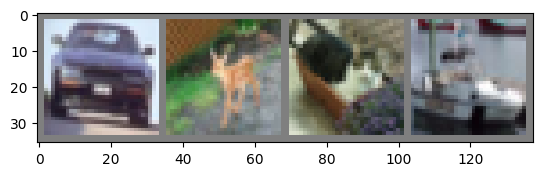

car   deer  cat   ship 


In [8]:
import matplotlib.pyplot as plt
import numpy as np

def imshow(img):
  img = img/2 + 0.5
  npimg = img.numpy()

  plt.imshow(np.transpose(npimg,(1,2,0)))
  plt.show()


dataiter = iter(train_loader)
img,label = next(dataiter)

imshow(torchvision.utils.make_grid(img))

print(' '.join(f'{classes[label[j]]:5s}' for j in range(batch_sizes)))


def imshow_weird(img):
  img = img/2+0.5
  plt.imshow(img,cmap='viridis')
  plt.show()



In [39]:
#Iteration 1 model used :

import torch.nn as nn
import torch.nn.functional as F

activations = {}

def get_activation(name):
  def hook(model,input,output):
    activations[name]=output.detach()
  return hook

class Net(nn.Module):
  def __init__(self, *args, **kwargs) -> None:
    super().__init__(*args, **kwargs)
    self.conv1 = nn.Conv2d(3,6,5)
    self.pool = nn.MaxPool2d(2,2) #Doesnt affect the channel.
    self.conv2 = nn.Conv2d(6,16,5)
    self.fc1 = nn.Linear(16*5*5,120)
    self.fc2 = nn.Linear(120,84)
    self.fc3 = nn.Linear(84,10)


  def forward(self,x):
    x = self.pool(F.relu(self.conv1(x)))
    x = self.pool(F.relu(self.conv2(x)))

    x = torch.flatten(x,1)
    x = F.relu(self.fc1(x))
    x = F.relu(self.fc2(x))

    x = self.fc3(x)
    return x

net1 = Net()

In [40]:
#Iteration 2 model used :

import torch.nn as nn
import torch.nn.functional as F

activations = {}

def get_activation(name):
  def hook(model,input,output):
    activations[name]=output.detach()
  return hook

class Net(nn.Module):
  def __init__(self, *args, **kwargs) -> None:
    super().__init__(*args, **kwargs)
    self.conv1 = nn.Conv2d(3,64,kernel_size=3,stride=1,padding=1)
    self.batchNorm1 = nn.BatchNorm2d(64)
    self.conv2 = nn.Conv2d(64,64,kernel_size=3,stride=1,padding=1)
    self.batchNorm2 = nn.BatchNorm2d(64)
    self.conv3 = nn.Conv2d(64,128,kernel_size=3,stride=1,padding=1)
    self.batchNorm3 = nn.BatchNorm2d(128)
    self.fc1 = nn.Linear(128*32*32,120)
    self.fc2 = nn.Linear(120,84)
    self.fc3 = nn.Linear(84,10)


  def forward(self,x):
    x = self.conv1(x)
    x = self.batchNorm1(x)
    x = F.relu(x)
    x = self.conv2(x)
    x = self.batchNorm2(x)
    x = F.relu(x)
    x = self.conv3(x)
    x = self.batchNorm3(x)
    x = F.relu(x)


    x = torch.flatten(x,1)
    x = F.relu(self.fc1(x))
    x = F.relu(self.fc2(x))

    x = self.fc3(x)
    return x

net2 = Net()


In [41]:
import torch.optim as optim

criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(net2.parameters(),lr=0.001,momentum=0.9)

In [17]:
from torch.utils.data import dataloader
from tqdm import tqdm
from torch.utils.tensorboard import SummaryWriter
import time


num_epochs = 20
device = torch.device('cuda:0' if torch.cuda.is_available else 'cpu')
print("Device available ",device)
net2.train()
net2.to(device)
writer = SummaryWriter()
count = 0

for epoch in tqdm(range(num_epochs)):
  total_loss=0
  num_item = 0
  running_loss = 0
  last_loss = 0

  for i, data in enumerate(train_loader):
    count+=1
    input,labels = data[0].to(device),data[1].to(device)

    optimizer.zero_grad()

    outputs = net2(input)
    loss = criterion(outputs,labels)
    loss.backward()
    optimizer.step()

    num_item += batch_sizes
    running_loss += loss.item()
    if(i%1000==999):
      last_loss = running_loss/1000
      print(' batch{}loss:{}'.format(i+1,last_loss))
      tb_x = epoch*len(train_loader)+i+1
      writer.add_scalar('Loss/Train',last_loss,tb_x)
      running_loss = 0

PATH = 'classifier_model_vgg_part.pt'
torch.save(net2.state_dict(),PATH)
print('Training done')

Device available  cuda:0


  0%|          | 0/20 [00:00<?, ?it/s]

 batch1000loss:1.068481323581189
 batch2000loss:1.1153386398404836
 batch3000loss:1.0452677697986363
 batch4000loss:1.0370572572499515
 batch5000loss:1.024290198052302
 batch6000loss:1.0001729398220778
 batch7000loss:0.9898753215316684
 batch8000loss:0.9868555657864199
 batch9000loss:0.9805609256010502
 batch10000loss:0.9926641020774841
 batch11000loss:0.9637323630563914
 batch12000loss:0.9530887153800577


  5%|▌         | 1/20 [01:36<30:24, 96.01s/it]

 batch1000loss:0.814608607204631
 batch2000loss:0.808420491094701
 batch3000loss:0.8377854662043974
 batch4000loss:0.7829426595428959
 batch5000loss:0.7749269356369041
 batch6000loss:0.8127838709736243
 batch7000loss:0.8223305726596154
 batch8000loss:0.8030960858119651
 batch9000loss:0.7937787391860038
 batch10000loss:0.8049354676418007
 batch11000loss:0.7658792913882062
 batch12000loss:0.7789752849370707


 10%|█         | 2/20 [03:12<28:55, 96.44s/it]

 batch1000loss:0.5982194469245151
 batch2000loss:0.6271318475847365
 batch3000loss:0.5921138797628228
 batch4000loss:0.5991142860939727
 batch5000loss:0.6262148460089229
 batch6000loss:0.6629999037580565
 batch7000loss:0.668855896586203
 batch8000loss:0.6200158736075391
 batch9000loss:0.6642929977215827
 batch10000loss:0.6357103955341153
 batch11000loss:0.6620830276436173
 batch12000loss:0.6559309867806733


 15%|█▌        | 3/20 [04:48<27:13, 96.10s/it]

 batch1000loss:0.4094566859008046
 batch2000loss:0.4434517246161122
 batch3000loss:0.49006028938968665
 batch4000loss:0.49803583668533247
 batch5000loss:0.4809745053119841
 batch6000loss:0.49404757331023574
 batch7000loss:0.463954159950561
 batch8000loss:0.5085700041734381
 batch9000loss:0.5094923251412693
 batch10000loss:0.5204508341634646
 batch11000loss:0.5283822214563842
 batch12000loss:0.48729435017157813


 20%|██        | 4/20 [06:25<25:42, 96.38s/it]

 batch1000loss:0.3099860337955688
 batch2000loss:0.30991207615862365
 batch3000loss:0.3250410627975434
 batch4000loss:0.32869601135293486
 batch5000loss:0.352472246917343
 batch6000loss:0.3671427743215463
 batch7000loss:0.36085697929909294
 batch8000loss:0.38578383443615166
 batch9000loss:0.3660667870879406
 batch10000loss:0.38490973749435214
 batch11000loss:0.3833379529535887
 batch12000loss:0.3732173287065816


 25%|██▌       | 5/20 [08:01<24:03, 96.21s/it]

 batch1000loss:0.2091494811557859
 batch2000loss:0.21771908228557732
 batch3000loss:0.24075915452408664
 batch4000loss:0.260629137169366
 batch5000loss:0.2536634938436273
 batch6000loss:0.2560704252910573
 batch7000loss:0.2497786394629111
 batch8000loss:0.25860789188334454
 batch9000loss:0.2673780718478083
 batch10000loss:0.2640707856545596
 batch11000loss:0.2982105425285081
 batch12000loss:0.30663188408564385


 30%|███       | 6/20 [09:37<22:28, 96.31s/it]

 batch1000loss:0.15729117401898565
 batch2000loss:0.15728570239813416
 batch3000loss:0.1836392207123554
 batch4000loss:0.17895640870668103
 batch5000loss:0.18536227526635138
 batch6000loss:0.20559949195771787
 batch7000loss:0.21005564649184089
 batch8000loss:0.19319208483600572
 batch9000loss:0.2140924843765315
 batch10000loss:0.2062395234602259
 batch11000loss:0.21540987252971353
 batch12000loss:0.20532845284287576


 35%|███▌      | 7/20 [11:14<20:52, 96.35s/it]

 batch1000loss:0.10896373038312777
 batch2000loss:0.12347494474462746
 batch3000loss:0.13368101705801927
 batch4000loss:0.1292028963598965
 batch5000loss:0.13771190848889636
 batch6000loss:0.15245522060976147
 batch7000loss:0.13992094059877802
 batch8000loss:0.14999123638131617
 batch9000loss:0.1427630211326741
 batch10000loss:0.13731590000236202
 batch11000loss:0.16096995314399692
 batch12000loss:0.1795384172125814


 40%|████      | 8/20 [12:51<19:18, 96.58s/it]

 batch1000loss:0.08107835661771241
 batch2000loss:0.09256381186164069
 batch3000loss:0.09249382966778978
 batch4000loss:0.10987704148401116
 batch5000loss:0.0956648364269114
 batch6000loss:0.10101476948290224
 batch7000loss:0.10809034659836458
 batch8000loss:0.10887813949721659
 batch9000loss:0.10347143562583141
 batch10000loss:0.12281177954195073
 batch11000loss:0.13286740197714425
 batch12000loss:0.13795777246545077


 45%|████▌     | 9/20 [14:27<17:40, 96.41s/it]

 batch1000loss:0.08613035285282285
 batch2000loss:0.07709208605588697
 batch3000loss:0.07611951792232134
 batch4000loss:0.09581751329739381
 batch5000loss:0.07155158770966932
 batch6000loss:0.08835753380216033
 batch7000loss:0.09301157510967528
 batch8000loss:0.09920489861201497
 batch9000loss:0.10068132138188199
 batch10000loss:0.11044667130762309
 batch11000loss:0.10204655959893222
 batch12000loss:0.11597797516603749


 50%|█████     | 10/20 [16:04<16:06, 96.61s/it]

 batch1000loss:0.05946918975379569
 batch2000loss:0.05618141071767618
 batch3000loss:0.04492472936519493
 batch4000loss:0.06819749354686172
 batch5000loss:0.07745407315447896
 batch6000loss:0.0866139050466482
 batch7000loss:0.05514647437008509
 batch8000loss:0.07349014580029792
 batch9000loss:0.07404838104573744
 batch10000loss:0.08115609176166191
 batch11000loss:0.0921436032629279
 batch12000loss:0.0986158232400503


 55%|█████▌    | 11/20 [17:40<14:27, 96.38s/it]

 batch1000loss:0.04910294553368867
 batch2000loss:0.059522434919770974
 batch3000loss:0.05073500923627994
 batch4000loss:0.05473593451860659
 batch5000loss:0.044654916949242326
 batch6000loss:0.046101624371739335
 batch7000loss:0.061918522801284355
 batch8000loss:0.07176539947272198
 batch9000loss:0.06635615517595034
 batch10000loss:0.0708414688453041
 batch11000loss:0.060310204106647516
 batch12000loss:0.07558718474281169


 60%|██████    | 12/20 [19:17<12:53, 96.66s/it]

 batch1000loss:0.04719910003471256
 batch2000loss:0.038009832549763416
 batch3000loss:0.033495157185258376
 batch4000loss:0.04473207771493296
 batch5000loss:0.06216445318891914
 batch6000loss:0.052387936891361904
 batch7000loss:0.06414462486237724
 batch8000loss:0.03738886058628317
 batch9000loss:0.04210051954839026
 batch10000loss:0.058993109773793
 batch11000loss:0.06408228778788813
 batch12000loss:0.05416971345194001


 65%|██████▌   | 13/20 [20:54<11:18, 96.89s/it]

 batch1000loss:0.05295926820986914
 batch2000loss:0.041121062495749636
 batch3000loss:0.03938403070247866
 batch4000loss:0.05419101758433282
 batch5000loss:0.04791037021695213
 batch6000loss:0.04796989708652734
 batch7000loss:0.03437835711438135
 batch8000loss:0.045380968826640736
 batch9000loss:0.05488517720655546
 batch10000loss:0.05653539179718639
 batch11000loss:0.04964310030069415
 batch12000loss:0.04490234520976599


 70%|███████   | 14/20 [22:32<09:42, 97.11s/it]

 batch1000loss:0.023158300319767768
 batch2000loss:0.02914775286742446
 batch3000loss:0.03233642250897326
 batch4000loss:0.03854318207640258
 batch5000loss:0.04046495012170312
 batch6000loss:0.038895268345956024
 batch7000loss:0.041968206991347276
 batch8000loss:0.05252901201190388
 batch9000loss:0.04430001901145904
 batch10000loss:0.053526129855341165
 batch11000loss:0.04219609471078884
 batch12000loss:0.04109035173458098


 75%|███████▌  | 15/20 [24:09<08:05, 97.06s/it]

 batch1000loss:0.040499757330220695
 batch2000loss:0.03208384777075747
 batch3000loss:0.028234991944590015
 batch4000loss:0.02206719063100517
 batch5000loss:0.030478612929917517
 batch6000loss:0.039279960477803036
 batch7000loss:0.025491868369427677
 batch8000loss:0.03306490855107781
 batch9000loss:0.039050134774458796
 batch10000loss:0.03398435128229667
 batch11000loss:0.038721504958745885
 batch12000loss:0.04181369009636061


 80%|████████  | 16/20 [25:47<06:29, 97.27s/it]

 batch1000loss:0.01975943928571752
 batch2000loss:0.022161506237284547
 batch3000loss:0.02621569232929935
 batch4000loss:0.03225298259822303
 batch5000loss:0.0418819490799191
 batch6000loss:0.03241637685015246
 batch7000loss:0.03270726032884433
 batch8000loss:0.037167921885994604
 batch9000loss:0.03993553025837191
 batch10000loss:0.029898969448270918
 batch11000loss:0.0361801542617604
 batch12000loss:0.03434862744434548


 85%|████████▌ | 17/20 [27:24<04:51, 97.24s/it]

 batch1000loss:0.019835783161767366
 batch2000loss:0.016664112541694514
 batch3000loss:0.023936211516347585
 batch4000loss:0.019108334673665576
 batch5000loss:0.019774167522854973
 batch6000loss:0.022741079152212577
 batch7000loss:0.01944134100063432
 batch8000loss:0.02312335114448262
 batch9000loss:0.02245417657880023
 batch10000loss:0.023587012139929874
 batch11000loss:0.03109563676363699
 batch12000loss:0.02987589931253582


 90%|█████████ | 18/20 [29:15<03:22, 101.34s/it]

 batch1000loss:0.008463062492459013
 batch2000loss:0.01031127406917463
 batch3000loss:0.015261388005622021
 batch4000loss:0.01681643267432942
 batch5000loss:0.018984279749319072
 batch6000loss:0.01877413320100076
 batch7000loss:0.019850500864693445
 batch8000loss:0.01893110298564397
 batch9000loss:0.016395166858498306
 batch10000loss:0.02049282472522743
 batch11000loss:0.017882826019787308
 batch12000loss:0.019307473490987912


 95%|█████████▌| 19/20 [31:14<01:46, 106.86s/it]

 batch1000loss:0.012171094170646048
 batch2000loss:0.01599129349590322
 batch3000loss:0.014406140650927927
 batch4000loss:0.015077591185838577
 batch5000loss:0.020010496340110956
 batch6000loss:0.008322127283655344
 batch7000loss:0.01372011066694124
 batch8000loss:0.013212116077160493
 batch9000loss:0.01568201341518579
 batch10000loss:0.03296580172294939
 batch11000loss:0.03591102579191215
 batch12000loss:0.019578497992021174


100%|██████████| 20/20 [32:54<00:00, 98.70s/it] 

Training done


Test set accuracy

In [35]:
correct = 0
total = 0
net2.load_state_dict(torch.load('classifier_model_vgg_part.pt'),strict=True)
net2.eval()
net2.to(device)
test_loader = torch.utils.data.DataLoader(testset,batch_size = batch_sizes,num_workers=3,shuffle=True)
for data in test_loader:
  images,labels = data
  images = images.to(device)
  labels = labels.to(device)
  output = net2(images)
  #print(output.shape)
  predicted = output.argmax(axis=0)
  for i in range(labels.shape[0]):
    predicted = output[i].argmax(axis=0)
    correct+=(predicted==labels[i])
  total+=labels.shape[0]
  #correct+=(predicted==labels).sum().item()
print("Total ",total)
print("correct ",correct)
print("The accuracy is ",100*(correct/total))


Total  10000
correct  tensor(6970, device='cuda:0')
The accuracy is  tensor(69.7000, device='cuda:0')


Loading the model after subsequent saves :

In [12]:
device = torch.device('cuda:0' if torch.cuda.is_available else 'cpu')
print("Device available ",device)
net2.load_state_dict(torch.load('classifier_model_vgg_part.pt'),strict=True)
net2.to(device)


Device available  cuda:0


Net(
  (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (batchNorm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (batchNorm2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (batchNorm3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (fc1): Linear(in_features=131072, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=10, bias=True)
)

In [42]:
%load_ext tensorboard
%tensorboard --logdir 'runs'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

Test image oda shape  torch.Size([4, 3, 32, 32])
Output shape  torch.Size([4, 10])
Predicted label truck
Target Label :  truck
torch.Size([32, 32])


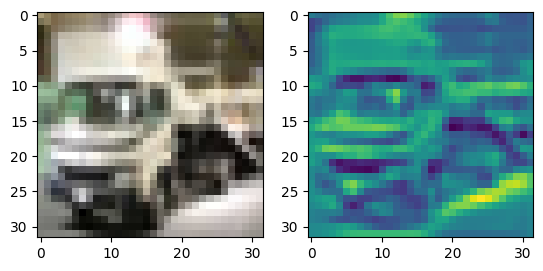

Predicted label dog
Target Label :  dog
torch.Size([32, 32])


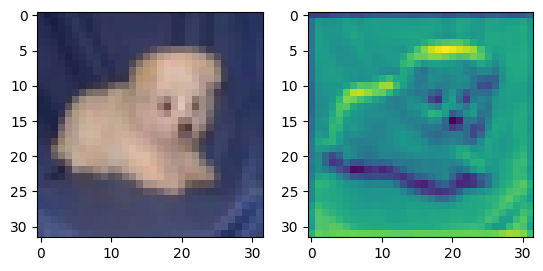

Predicted label horse
Target Label :  horse
torch.Size([32, 32])


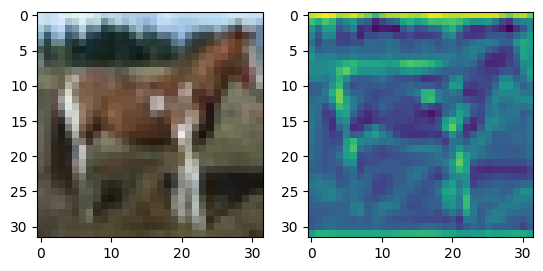

Predicted label bird
Target Label :  bird
torch.Size([32, 32])


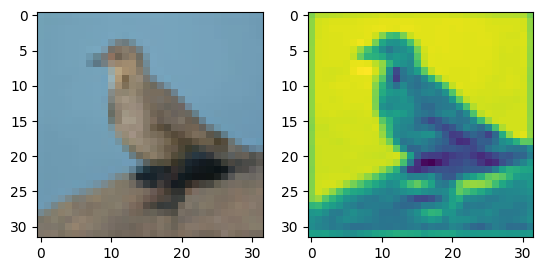

Activation shape  torch.Size([4, 64, 32, 32])
Activation shape  torch.Size([4, 64, 32, 32])


In [36]:
import matplotlib.pyplot as plt


def image_show(img1,img2):
  img1 = img1/2 + 0.5
  img2 = img2/2 + 0.5
  f = plt.figure()
  f.add_subplot(1,2, 1)
  npimg1 = img1.numpy()
  plt.imshow(np.transpose(npimg1,(1,2,0)))
  f.add_subplot(1,2, 2)
  npimg2 = img2.numpy()
  plt.imshow(npimg2)
  plt.show(block=True)

net2.eval()

net2.conv1.register_forward_hook(get_activation('conv1'))
net2.conv2.register_forward_hook(get_activation('conv2'))
net2.conv3.register_forward_hook(get_activation('conv3'))
test_loader = torch.utils.data.DataLoader(testset,batch_size = batch_sizes,num_workers=3,shuffle=True)
for test_image,label in iter(test_loader):

  test_image = test_image.to(device)
  label = label.to(device)
  print("Test image oda shape ",test_image.shape)
  output = net2(test_image)
  print("Output shape ",output.shape)
  for i in range(4):
    print("Predicted label",classes[output[i].argmax(axis=0)])
    print("Target Label : ",classes[label[i]])
    #print("Conv1 shape : ",activation['conv1'][i].cpu().shape)
    itt = activations['conv1'][i][3]
    print(itt.shape)
    image_show(test_image[i].cpu(),itt.cpu())
    #imshow(test_image[i].cpu())
    #imshow_weird(itt.cpu())
  break
  #print("Index :",max_index,label)
  #print(label.shape,label)
#The Activations :
print("Activation shape ",activations['conv1'].shape)
print("Activation shape ",activations['conv2'].shape)

#print()

Layer name  conv1
Layer name  conv2
Layer name  conv3
Layer name  conv1
Layer name  conv2
Layer name  conv3
Layer name  conv1
Layer name  conv2
Layer name  conv3
Layer name  conv1
Layer name  conv2
Layer name  conv3


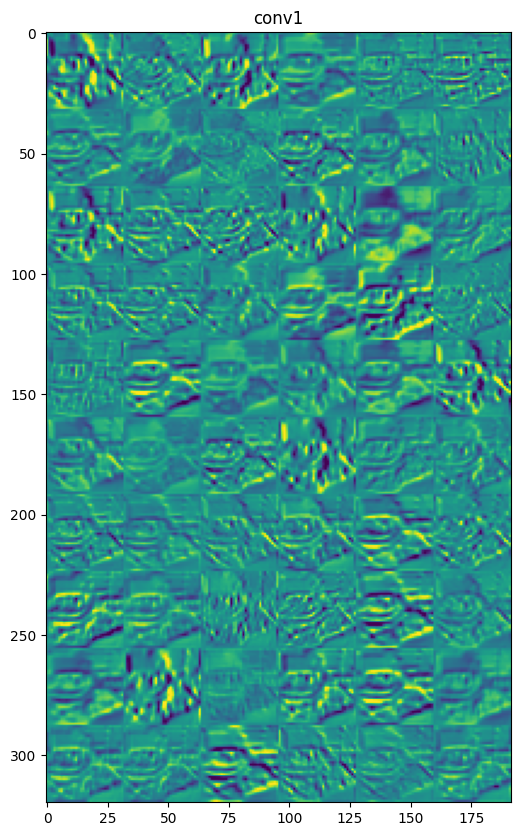

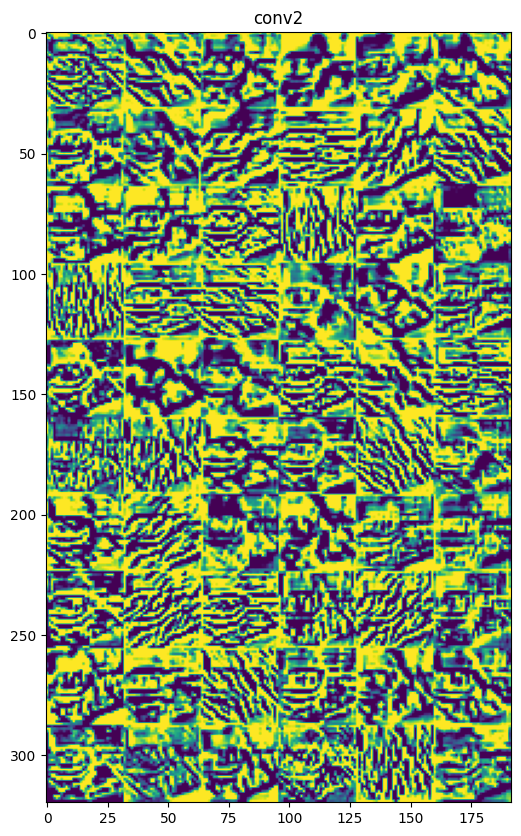

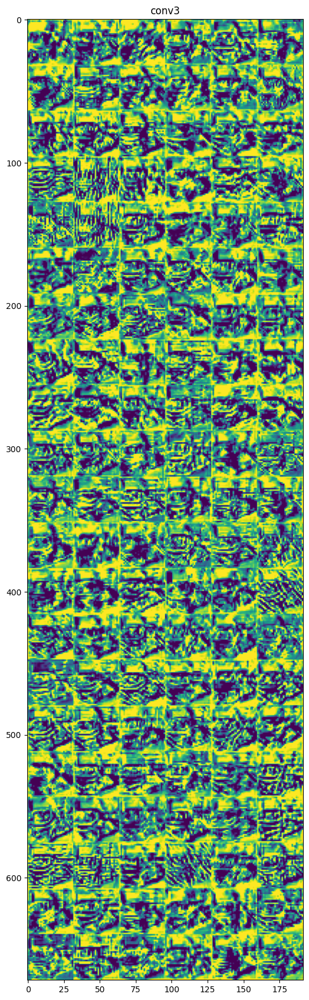

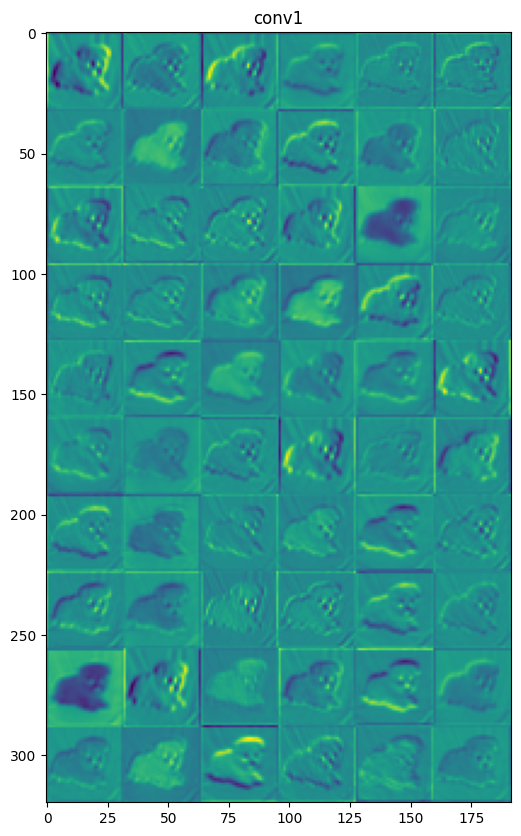

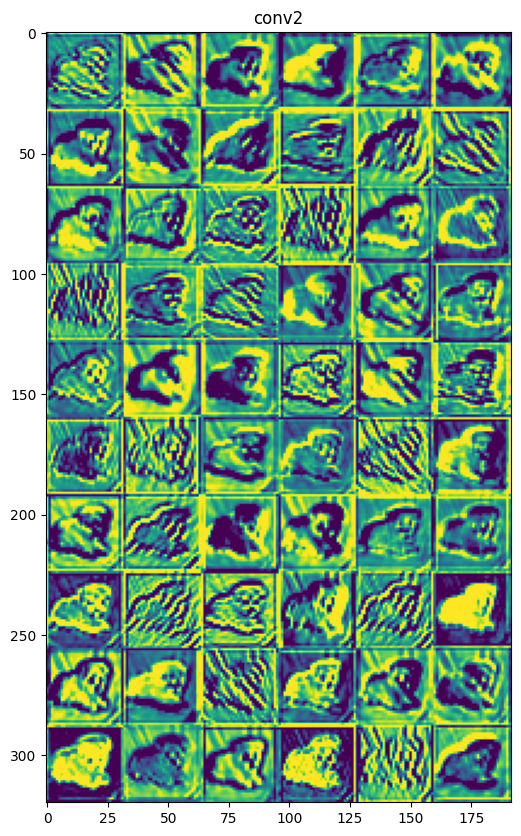

...

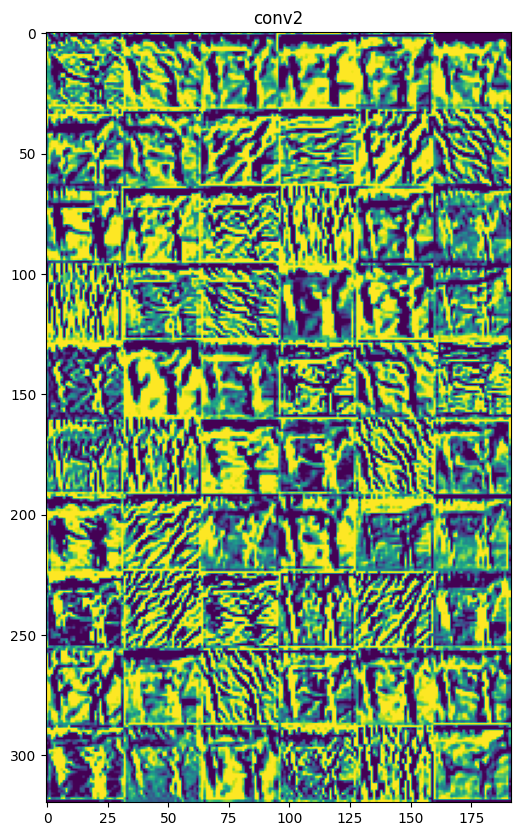

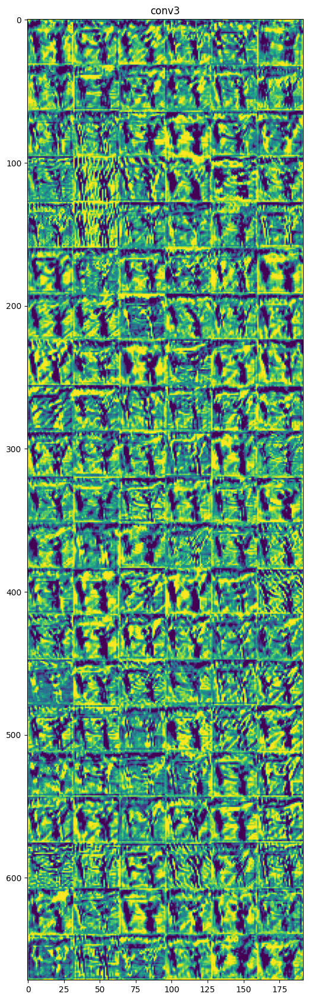

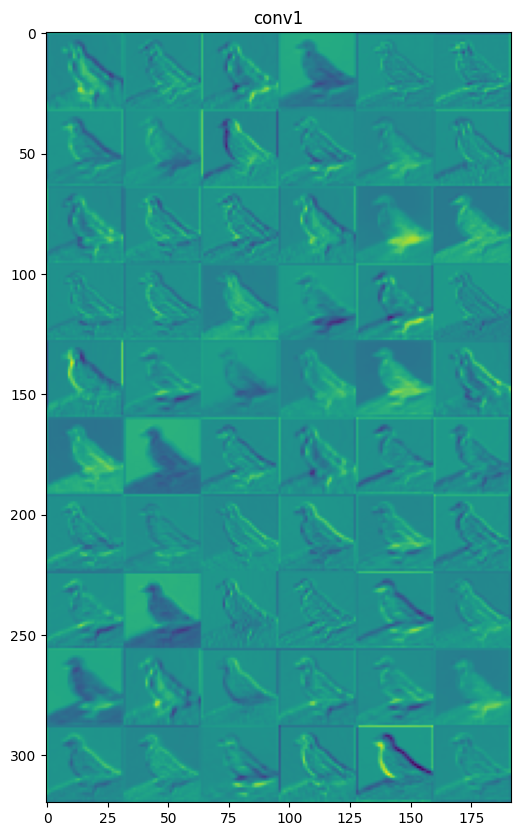

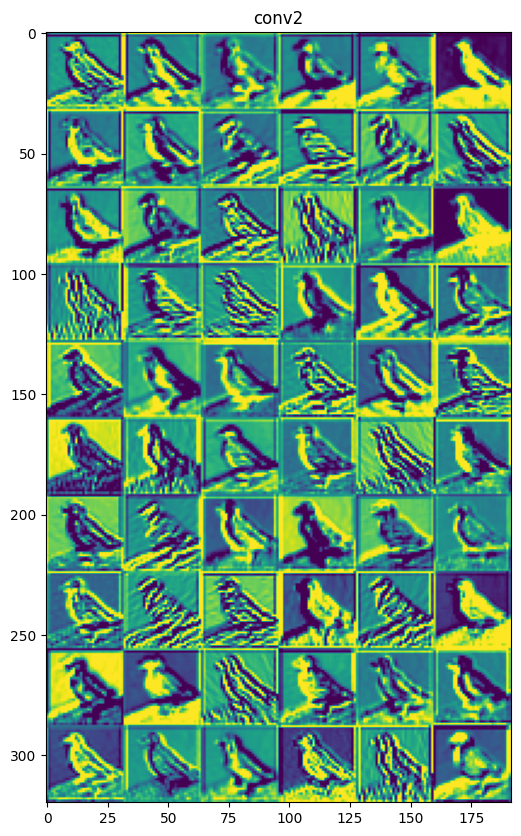

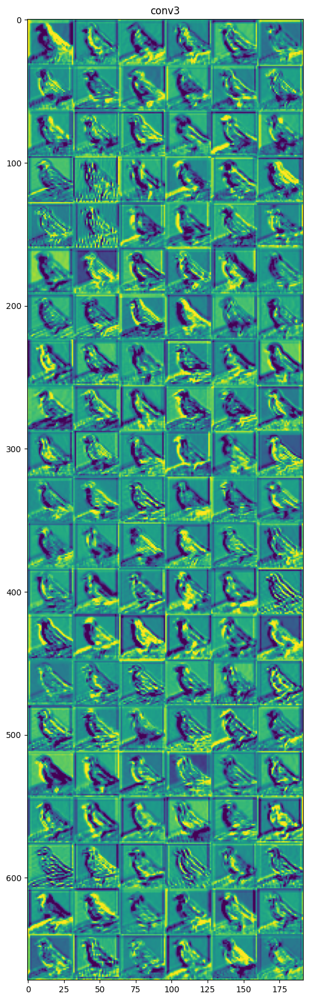

In [38]:
layer_names = []
layer_names.append("conv1")
layer_names.append("conv2")
layer_names.append("conv3")

images_per_row = 6
for i in range(4):
  for layer_name in layer_names:
    #print("layer name ",layer_names," layer activation ",activations[layer_name])
    #print("Layer name ",layer_name)
    layer_activation = activations[layer_name].cpu()
    #print(layer_activation.shape)
    n_features = layer_activation.shape[1]
    size = layer_activation.shape[2]
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size*n_cols,images_per_row*size))
    #print("n_cols ",n_cols)
    #print("n_features ",n_features)
    for col in range(n_cols):
      for row in range(images_per_row):
        channel_image = layer_activation[i,col*images_per_row+row,:,:].cpu().numpy()
        #print("Channel image shape ",channel_image.shape)
        channel_image -= channel_image.mean()
        channel_image *=64
        channel_image+=128
        channel_image = np.clip(channel_image,0,255).astype('uint8')
        display_grid[col*size:(col+1)*size,row*size:(row+1)*size] = channel_image
    scale = 1/size
    plt.figure(figsize = (scale*display_grid.shape[1],scale*display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid,aspect='auto',cmap='viridis')
    #print("n_feature ",n_features)
plt.show()